In [2]:

import pandas as pd
from wordcloud import WordCloud, STOPWORDS
import seaborn as sns
import re
import string
from collections import Counter, defaultdict
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.offline import plot

import matplotlib.gridspec as gridspec
from matplotlib.ticker import MaxNLocator
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import altair as alt
import os
import random
from pathlib import Path
import json


In [5]:
from google.colab import files


uploaded = files.upload()

Saving Reddit_Data.csv to Reddit_Data.csv
Saving Twitter_Data.csv to Twitter_Data.csv


In [69]:
from google.colab import files
def getLocalFiles():
    _files = files.upload()
    if len(_files) >0:
       for k,v in _files.items():
         open(k,'wb').write(v)
getLocalFiles()

Saving UDA_pytorch_utils.py to UDA_pytorch_utils (1).py


In [3]:
tweets_df=pd.read_csv('twitter_data/Twitter_Data.csv')
reddit_df=pd.read_csv('twitter_data/Reddit_Data.csv')

In [4]:
tweets_df.head()

,clean_text,category
0,when modi promised “minimum government maximum...,-1.0
1,talk all the nonsense and continue all the dra...,0.0
2,what did just say vote for modi welcome bjp t...,1.0
3,asking his supporters prefix chowkidar their n...,1.0
4,answer who among these the most powerful world...,1.0


In [5]:
reddit_df.head()

,clean_comment,category
0,family mormon have never tried explain them t...,1
1,buddhism has very much lot compatible with chr...,1
2,seriously don say thing first all they won get...,-1
3,what you have learned yours and only yours wha...,0
4,for your own benefit you may want read living ...,1


In [6]:
reddit_df.rename(columns={'clean_comment': 'clean_text'},inplace=True)

In [7]:
reddit_df.head()

,clean_text,category
0,family mormon have never tried explain them t...,1
1,buddhism has very much lot compatible with chr...,1
2,seriously don say thing first all they won get...,-1
3,what you have learned yours and only yours wha...,0
4,for your own benefit you may want read living ...,1


In our datasets,


*   0 indicates a Neutral tweet/comment
*   1 indicates a Positive tweet/comment
*   -1 indicates a Negative tweet/comment



In [8]:
merged_df=pd.concat([tweets_df,reddit_df],ignore_index=True)
merged_df.head()

,clean_text,category
0,when modi promised “minimum government maximum...,-1.0
1,talk all the nonsense and continue all the dra...,0.0
2,what did just say vote for modi welcome bjp t...,1.0
3,asking his supporters prefix chowkidar their n...,1.0
4,answer who among these the most powerful world...,1.0


**Exploratary Data Analysis**

In [9]:
merged_df.isna().sum()

clean_text    104
category        7
dtype: int64

In [10]:
merged_df.dropna(axis=0,inplace=True)

In [11]:
merged_df.isna().sum()

clean_text    0
category      0
dtype: int64

Category counts

<AxesSubplot:xlabel='category'>

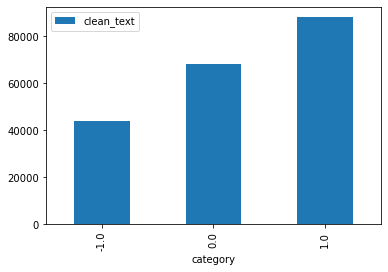

In [12]:
merged_df.groupby('category').count().plot(kind='bar')

Word counts in different categories

In [13]:
merged_df['length']=merged_df.clean_text.apply(lambda x: len(x.split()))

In [14]:
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

In [15]:
alt.Chart(merged_df[merged_df['category']==1],title='word count for positive tweets/comments').mark_bar().encode(
    x=alt.X("length", title=None, axis=alt.Axis(labels=True, ticks=False)),
    y='count()'
)

#scale=alt.Scale(domainMin=0))

alt.Chart(...)

In [16]:
merged_df[merged_df['category']==1]['length'].describe()

count    88079.000000
mean        26.269701
std         33.555206
min          1.000000
25%         13.000000
50%         22.000000
75%         33.000000
max       1307.000000
Name: length, dtype: float64

In [17]:
alt.Chart(merged_df[merged_df['category']==0],title='word count for neutral tweets/comments').mark_bar().encode(
    x=alt.X("length", title=None, axis=alt.Axis(labels=True, ticks=False)),
    y='count()'
)

alt.Chart(...)

In [18]:
merged_df[merged_df['category']==0]['length'].describe()

count    68253.000000
mean        13.407235
std         10.152172
min          0.000000
25%          6.000000
50%         11.000000
75%         18.000000
max        518.000000
Name: length, dtype: float64

In [19]:
alt.Chart(merged_df[merged_df['category']==-1],title='word count for negative tweets/comments').mark_bar().encode(
    x=alt.X("length", title=None, axis=alt.Axis(labels=True, ticks=False)),
    y='count()'
)

alt.Chart(...)

In [20]:
merged_df[merged_df['category']==-1]['length'].describe()

count    43786.000000
mean        25.943498
std         24.990777
min          1.000000
25%         14.000000
50%         23.000000
75%         33.000000
max        865.000000
Name: length, dtype: float64

Percentage distribution of differerent sentiments

In [21]:
import plotly.express as px
fig = px.pie(merged_df, names='category', title ='Pie chart of different sentiments of tweets')
fig.show()

**Word Clouds**

In [26]:
def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='black',
        max_words=200,
        max_font_size=40,
        scale=1,
        random_state=1
).generate(" ".join(data))

    fig = plt.figure(1, figsize=(15, 15))
    plt.axis('off')
    if title:
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

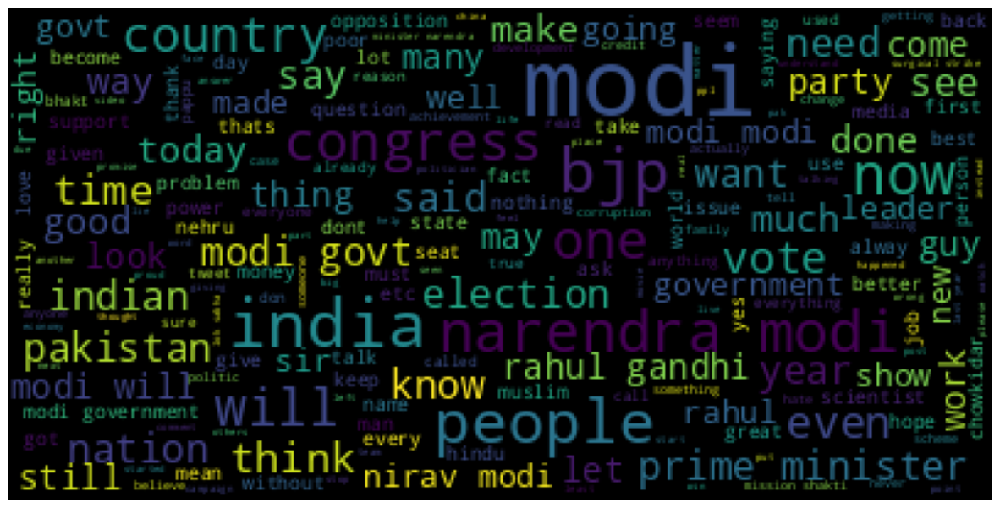

In [27]:
show_wordcloud(merged_df['clean_text'].values)

**Data Preprocessing**

In [28]:
stopWords = set(STOPWORDS)

In [29]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [30]:
# Remove all URLs, replace by URL
def remove_URL(text):
    url = re.compile(r'https?://\S+|www\.\S+')
    return url.sub(r'URL',str(text))


# Remove HTML beacon
def remove_HTML(text):
    html=re.compile(r'<.*?>')
    return html.sub(r'',text)

# Remove non printable characters
def remove_not_ASCII(text):
    text = ''.join([word for word in text if word in string.printable])
    return text


# Remove @ and mention, replace by USER
def remove_mention(text):
    at=re.compile(r'@\S+')
    return at.sub(r'USER',text)


# Remove numbers, replace it by NUMBER
def remove_number(text):
    num = re.compile(r'[-+]?[.\d]*[\d]+[:,.\d]*')
    return num.sub(r'NUMBER', text)



# Replace some others smileys with SADFACE
def transcription_sad(text):
    eyes = "[8:=;]"
    nose = "['`\-]"
    smiley = re.compile(r'[8:=;][\'\-]?[(\\/]')
    return smiley.sub(r'SADFACE', text)


# Replace some smileys with SMILE
def transcription_smile(text):
    eyes = "[8:=;]"
    nose = "['`\-]"
    smiley = re.compile(r'[8:=;][\'\-]?[)dDp]')
    #smiley = re.compile(r'#{eyes}#{nose}[)d]+|[)d]+#{nose}#{eyes}/i')
    return smiley.sub(r'SMILE', text)


# Replace <3 with HEART
def transcription_heart(text):
    heart = re.compile(r'<3')
    return heart.sub(r'HEART', text)


# Factorize elongated words, add ELONG
def remove_elongated_words(text):
    rep = re.compile(r'\b(\S*?)([a-z])\2{2,}\b')
    return rep.sub(r'\1\2 ELONG', text)


# Factorize repeated punctuation, add REPEAT
def remove_repeat_punct(text):
    rep = re.compile(r'([!?.]){2,}')
    return rep.sub(r'\1 REPEAT', text)



# Remove all punctuations
def remove_all_punct(text):
    table = str.maketrans('','',string.punctuation)
    return text.translate(table)


# Remove punctuations
def remove_punct(text):
    punctuations = '@#!?+&*[]-%.:/();$=><|{}^' + "'`"
    for p in punctuations:
        text = text.replace(p, f' {p} ')

    text = text.replace('...', ' ... ')
    if '...' not in text:
        text = text.replace('..', ' ... ')
    return text


# Remove all english stopwords
def remove_stopwords(text):
    text = ' '.join([word for word in text.split() if word not in stopWords.words("english")])
    return text

def stemming(text):
    ps = PorterStemmer()
    text = ' '.join([ps.stem(word) for word in text.split()])
    return text

def lemmatization(text):
    lm= WordNetLemmatizer()
    text = ' '.join([lm.lemmatize(word, pos='v') for word in text.split()])
    return text

In [31]:
def clean_text(text):

    # Remove non text
    text = remove_URL(text)
    text = remove_HTML(text)
    text = remove_not_ASCII(text)

    # Lower text, replace abbreviations
    text = remove_mention(text)
    text = remove_number(text)

    # Remove  smileys

    text = transcription_sad(text)
    text = transcription_smile(text)
    text = transcription_heart(text)

    # Remove repeated puntuations / words
    text = remove_elongated_words(text)
    text = remove_repeat_punct(text)

    text = remove_all_punct(text)
    text = remove_punct(text)
    text = lemmatization(text)
    text = text.lower()

    return text

In [32]:
import nltk
nltk.download('omw-1.4')

[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

In [33]:
merged_df['processed_text']=merged_df['clean_text'].apply(clean_text)

In [34]:
merged_df['category']=merged_df['category'].apply(lambda x: 2 if x==-1 else x)
merged_df.head()

,clean_text,category,length,processed_text
0,when modi promised “minimum government maximum...,2.0,33,when modi promise minimum government maximum g...
1,talk all the nonsense and continue all the dra...,0.0,13,talk all the nonsense and continue all the dra...
2,what did just say vote for modi welcome bjp t...,1.0,22,what do just say vote for modi welcome bjp tel...
3,asking his supporters prefix chowkidar their n...,1.0,34,ask his supporters prefix chowkidar their name...
4,answer who among these the most powerful world...,1.0,14,answer who among these the most powerful world...


In [35]:
from torchtext.data import get_tokenizer

In [40]:
tokenizer = get_tokenizer('spacy', language='en_core_web_sm')

In [36]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(merged_df,
                                    test_size=0.10,
                                    random_state=18,
                            stratify=merged_df.category.values)

proper_train_df, val_df = train_test_split(train_df,
                                    test_size=0.10,
                                    random_state=18,
                            stratify=train_df.category.values)

In [37]:
print("Training df size",proper_train_df.shape)
print("Validation df size",val_df.shape)
print("Testing df size",test_df.shape)

Training df size (162095, 4)
Validation df size (18011, 4)
Testing df size (20012, 4)


In [41]:
def tokenizer_lowercase(text):
    return [token.lower() for token in tokenizer(text)]

In [83]:
X = [tokenizer_lowercase(text) for text in merged_df['processed_text']]
Y=[label for label in merged_df['category']]

In [96]:
y = pd.get_dummies(merged_df['category'])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
X_proper_train, X_val, y_proper_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=1)

In [97]:
from sklearn.feature_extraction.text import CountVectorizer
#from sklearn.feature_extraction.text import TfidfVectorizer

vocabulary_size = 5000

# Tweets have already been preprocessed hence dummy function will be passed in
# to preprocessor & tokenizer step
count_vector = CountVectorizer(max_features=vocabulary_size,
#                               ngram_range=(1,2),    # unigram and bigram
                                preprocessor=lambda x: x,
                               tokenizer=lambda x: x)
#tfidf_vector = TfidfVectorizer(lowercase=True, stop_words='english')

# Fit the training data
X_proper_train = count_vector.fit_transform(X_train).toarray()

# Transform testing data
X_test = count_vector.transform(X_test).toarray()

/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'



### Building LSTM Model

In [91]:
import tensorflow as tf
from keras.preprocessing.text import Tokenizer
from keras.utils import pad_sequences

max_words = 5000
max_len=50

def tokenize_pad_sequences(text):
    '''
    This function tokenize the input text into sequnences of intergers and then
    pad each sequence to the same length
    '''
    # Text tokenization
    tokenizer = Tokenizer(num_words=max_words, lower=True, split=' ')
    tokenizer.fit_on_texts(text)
    # Transforms text to a sequence of integers
    X = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    X = pad_sequences(X, padding='post', maxlen=max_len)
    # return sequences
    return X, tokenizer

print('Before Tokenization & Padding \n', merged_df['processed_text'][0])
X, tokenizer = tokenize_pad_sequences(merged_df['processed_text'])
print('After Tokenization & Padding \n', X[0])

Before Tokenization & Padding 
 when modi promise minimum government maximum governance expect him begin the difficult job reform the state why do take years get justice state should and not business and should exit psus and temples
After Tokenization & Padding 
 [  49    2  127  891   77 1758  880  344   52  699    1 1098  113 1109
    1  125   37   18   45   67   29 1011  125   59    3   10  550    3
   59 2097    3 2204    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


In [92]:
import pickle

# saving
with open('tokenizer.pickle', 'wb') as handle:
    pickle.dump(tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

# loading
with open('tokenizer.pickle', 'rb') as handle:
    tokenizer = pickle.load(handle)

In [98]:
y = pd.get_dummies(merged_df['category'])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=1)
print('Train Set ->', X_train.shape, y_train.shape)
print('Validation Set ->', X_val.shape, y_val.shape)
print('Test Set ->', X_test.shape, y_test.shape)

Train Set -> (120070, 50) (120070, 3)
Validation Set -> (40024, 50) (40024, 3)
Test Set -> (40024, 50) (40024, 3)


In [95]:
import keras.backend as K

def f1_score(precision, recall):
    ''' Function to calculate f1 score '''

    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

In [99]:
from keras.models import Sequential
from keras.layers import Embedding, Conv1D, MaxPooling1D, Bidirectional, LSTM, Dense, Dropout
from keras.metrics import Precision, Recall
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras import datasets

from keras.callbacks import LearningRateScheduler
from keras.callbacks import History

from keras import losses

vocab_size = 5000
embedding_size = 32
epochs=20
learning_rate = 0.1
decay_rate = learning_rate / epochs
momentum = 0.8

sgd = SGD(lr=learning_rate, momentum=momentum, decay=decay_rate, nesterov=False)
# Build model
model= Sequential()
model.add(Embedding(vocab_size, embedding_size, input_length=max_len))
model.add(Conv1D(filters=32, kernel_size=3, padding='same', activation='relu'))
model.add(MaxPooling1D(pool_size=2))
model.add(Bidirectional(LSTM(32)))
model.add(Dropout(0.4))
model.add(Dense(3, activation='softmax'))

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/gradient_descent.py:114: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.



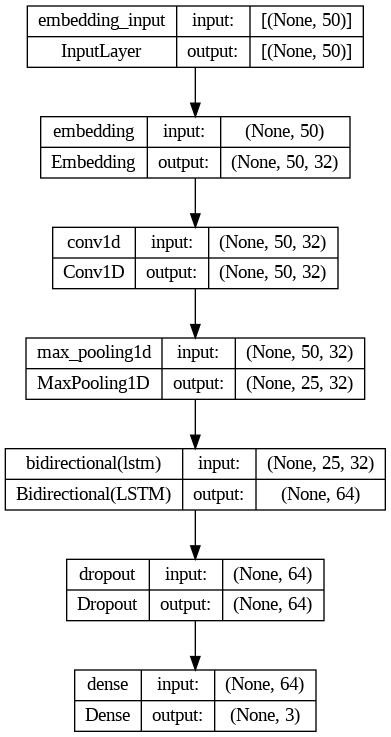

In [100]:
tf.keras.utils.plot_model(model, show_shapes=True)

In [101]:
print(model.summary())

# Compile model
model.compile(loss='categorical_crossentropy', optimizer=sgd,
               metrics=['accuracy', Precision(), Recall()])

# Train model

batch_size = 64
history = model.fit(X_train, y_train,
                      validation_data=(X_val, y_val),
                      batch_size=batch_size, epochs=epochs, verbose=1)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 50, 32)            160000    
                                                                 
 conv1d (Conv1D)             (None, 50, 32)            3104      
                                                                 
 max_pooling1d (MaxPooling1D  (None, 25, 32)           0         
 )                                                               
                                                                 
 bidirectional (Bidirectiona  (None, 64)               16640     
 l)                                                              
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense (Dense)               (None, 3)                 1

In [102]:
loss, accuracy, precision, recall = model.evaluate(X_test, y_test, verbose=0)
# Print metrics
print('')
print('Accuracy  : {:.4f}'.format(accuracy))
print('Precision : {:.4f}'.format(precision))
print('Recall    : {:.4f}'.format(recall))
print('F1 Score  : {:.4f}'.format(f1_score(precision, recall)))


Accuracy  : 0.8913
Precision : 0.8990
Recall    : 0.8830
F1 Score  : 0.8909


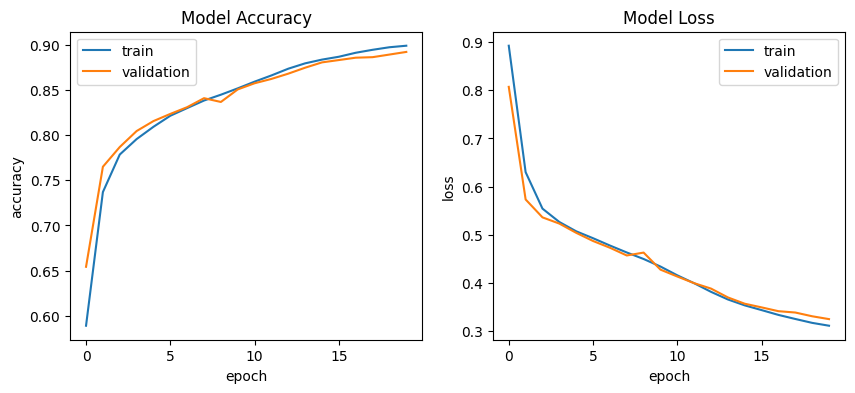

In [103]:
def plot_training_hist(history):
    '''Function to plot history for accuracy and loss'''

    fig, ax = plt.subplots(1, 2, figsize=(10,4))
    # first plot
    ax[0].plot(history.history['accuracy'])
    ax[0].plot(history.history['val_accuracy'])
    ax[0].set_title('Model Accuracy')
    ax[0].set_xlabel('epoch')
    ax[0].set_ylabel('accuracy')
    ax[0].legend(['train', 'validation'], loc='best')
    # second plot
    ax[1].plot(history.history['loss'])
    ax[1].plot(history.history['val_loss'])
    ax[1].set_title('Model Loss')
    ax[1].set_xlabel('epoch')
    ax[1].set_ylabel('loss')
    ax[1].legend(['train', 'validation'], loc='best')

plot_training_hist(history)

1251/1251 [==============================] - 4s 3ms/step


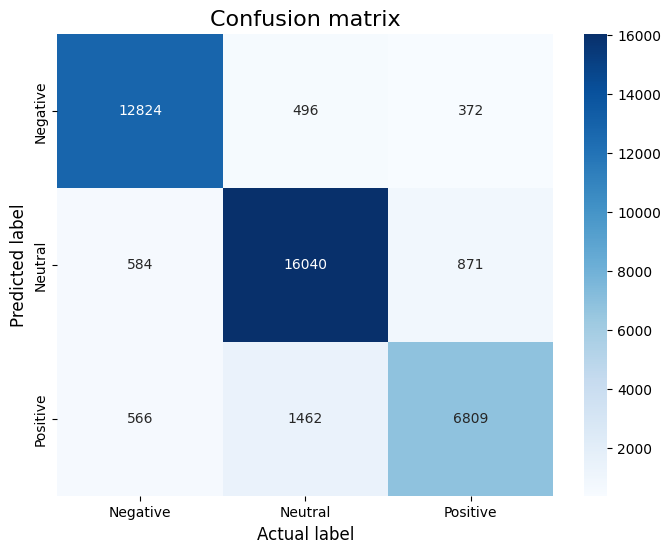

In [105]:
import numpy as np
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(model, X_test, y_test):
    '''Function to plot confusion matrix for the passed model and the data'''

    sentiment_classes = ['Negative', 'Neutral', 'Positive']
    # use model to do the prediction
    y_pred = model.predict(X_test)
    # compute confusion matrix
    cm = confusion_matrix(np.argmax(np.array(y_test),axis=1), np.argmax(y_pred, axis=1))
    # plot confusion matrix
    plt.figure(figsize=(8,6))
    sns.heatmap(cm, cmap=plt.cm.Blues, annot=True, fmt='d',
                xticklabels=sentiment_classes,
                yticklabels=sentiment_classes)
    plt.title('Confusion matrix', fontsize=16)
    plt.xlabel('Actual label', fontsize=12)
    plt.ylabel('Predicted label', fontsize=12)

plot_confusion_matrix(model, X_test, y_test)

In [106]:
# Save the model architecture & the weights
model.save('best_model.h5')
print('Best model saved')

Best model saved


In [107]:
from keras.models import load_model

# Load model
model = load_model('best_model.h5')

def predict_class(text):
    '''Function to predict sentiment class of the passed text'''

    sentiment_classes = ['Negative', 'Neutral', 'Positive']
    max_len=50

    # Transforms text to a sequence of integers using a tokenizer object
    xt = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    xt = pad_sequences(xt, padding='post', maxlen=max_len)
    # Do the prediction using the loaded model
    yt = model.predict(xt).argmax(axis=1)
    # Print the predicted sentiment
    print('The predicted sentiment is', sentiment_classes[yt[0]])

In [109]:
predict_class(['It is filthy politics of congress that have caused the average Indian to hate businessmen. In fact, these businessmen are the ones who pay the highest percentage of tax and also provide employment to lakhs of people in India. They deserve respect not hate'])

1/1 [==============================] - 0s 44ms/step
The predicted sentiment is Positive
